# Spotify Unwrapped: 2021

### This Spotify Unwrapped project is an exploratory data analysis into my streaming history for 2021. The goal of this project is to create my own Spotify wrapped analysis using Plotly interactive charts. I will explore Spotify data features and questions of my own to obtain some new insights into my musical listening patterns.  

## Findings:
- ~71% of my streams are skipped.
- The goal for my Spotify listening, in the future, is to reduce skipped percentage and maximize listening.
- I've streamed 636 unique artists and 2130 unique songs.
- My most streamed artists were Drake, Travis Scott, Kanye West, ASAP Rocky and Post Malone.
- The artists I skipped the most were Lil Uzi Vert and XXXTentacion.
- My most listened to songs were Laugh Now Cry Later, Forever, and The Bigger Picture.
- The songs I skipped the most are Mo Bamba and Myself.
- I tend to skip less popular songs than more popular songs, on average.
- All of my top 10 songs had an average listen percentage of ~50% or higher.
- I spent more time listening to Donda by Kanye West than Certified Lover Boy by Drake.
- I listened to music the most at night.
- I listened to a stream for longer, on average, in the mornings and on the weekends.

# Importing necessary modules

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from wordcloud import WordCloud
import seaborn as sns
import plotly.express as px
import plotly.figure_factory as ff
%matplotlib inline

# Loading the data

### Description of Spotify data: 

- **endTime**: Time of the stream
- **artistName**: Name of artist
- **trackName**: Name of track
- **msPlayed**: Milliseconds of stream
- **track_id**: ID of track
- **acousticness**: Measure of whether the track is acoustic
- **album**: Album of track
- **danceability**: Measure of how suitable a track is for dancing
- **energy**: Measure of intensity and activity of track
- **instrumentalness**: Prediction of whether a track contains no vocals
- **liveness**: Measure of presence of audience in recording
- **loudness**: Measure of loudness of track in decibels (dB)
- **popularity**: Measure of popularity of track scored by Spotify
- **release_date**: Release date of track
- **speechiness**: Measure of presence of spoken words in track
- **tempo**: Estimated tempo in beats per minute (BPM)
- **time_signature**: Time signature of track
- **track_length**: Duration of track in milliseconds



Right now, all of my spotify features are saved in different csv files so we must read them into dataframes and concatenate the dataframes for a combined analysis.

In [2]:
track_df = pd.read_csv('/Users/vineethravella/Desktop/DS_Projects/myspotify_project/data/extracted/streaming_track.csv', index_col=0)
acousticness_df = pd.read_csv('/Users/vineethravella/Desktop/DS_Projects/myspotify_project/data/extracted/acousticness.csv', index_col=0)
album_df = pd.read_csv('/Users/vineethravella/Desktop/DS_Projects/myspotify_project/data/extracted/album.csv', index_col=0)
danceability_df = pd.read_csv('/Users/vineethravella/Desktop/DS_Projects/myspotify_project/data/extracted/danceability.csv', index_col=0)
energy_df = pd.read_csv('/Users/vineethravella/Desktop/DS_Projects/myspotify_project/data/extracted/energy.csv', index_col=0)
instrumentalness_df = pd.read_csv('/Users/vineethravella/Desktop/DS_Projects/myspotify_project/data/extracted/instrumentalness.csv', index_col=0)
liveness_df = pd.read_csv('/Users/vineethravella/Desktop/DS_Projects/myspotify_project/data/extracted/liveness.csv', index_col=0)
loudness_df = pd.read_csv('/Users/vineethravella/Desktop/DS_Projects/myspotify_project/data/extracted/loudness.csv', index_col=0)
popularity_df = pd.read_csv('/Users/vineethravella/Desktop/DS_Projects/myspotify_project/data/extracted/popularity.csv', index_col=0)
release_df = pd.read_csv('/Users/vineethravella/Desktop/DS_Projects/myspotify_project/data/extracted/release_date.csv', index_col=0)
speechiness_df = pd.read_csv('/Users/vineethravella/Desktop/DS_Projects/myspotify_project/data/extracted/speechiness.csv', index_col=0)
tempo_df = pd.read_csv('/Users/vineethravella/Desktop/DS_Projects/myspotify_project/data/extracted/tempo.csv', index_col=0)
timesig_df = pd.read_csv('/Users/vineethravella/Desktop/DS_Projects/myspotify_project/data/extracted/time_signature.csv', index_col=0)
length_df = pd.read_csv('/Users/vineethravella/Desktop/DS_Projects/myspotify_project/data/extracted/track_length.csv', index_col=0)

In [3]:
df_list = [track_df, acousticness_df, album_df, danceability_df, energy_df, instrumentalness_df, liveness_df,
          loudness_df, popularity_df, release_df, speechiness_df, tempo_df, timesig_df, length_df]

for df in df_list:
    df.reset_index(drop=True, inplace=True)
    
streaming_df = pd.concat(df_list, axis=1)

streaming_df.head()

,endTime,artistName,trackName,msPlayed,track_id,acousticness,album,danceability,energy,instrumentalness,liveness,loudness,popularity,release_date,speechiness,tempo,time_signature,track_length
0,2020-12-23 08:30,Nujabes,Feather (feat. Cise Starr & Akin from CYNE),0,2ej1A2Ze6P2EOW7KfIosZR,0.6550,Modal Soul,0.565,0.749,0.432000,0.1060,-6.629,64.0,2005-11-11,0.0769,180.598,4.0,175360.0
1,2020-12-23 08:30,Cage The Elephant,Social Cues,430,1KuVdyg8d6NlRhbpHxg5UF,0.0119,Social Cues,0.668,0.913,0.000007,0.1110,-3.097,69.0,2019-04-19,0.0348,132.039,4.0,219053.0
2,2020-12-23 08:30,Glass Animals,Heat Waves,0,3USxtqRwSYz57Ewm6wWRMp,0.4400,Dreamland,0.761,0.525,0.000007,0.0921,-6.900,90.0,2020-08-07,0.0944,80.870,4.0,238805.0
3,2020-12-23 08:30,BROCKHAMPTON,RENTAL,477,4O9tOyMOq8Oioun2MsULH5,0.1940,SATURATION III,0.672,0.452,0.000000,0.2510,-7.947,61.0,2017-12-15,0.0738,82.012,4.0,213658.0
4,2020-12-23 08:30,Lostboycrow,The Lost Boy (feat. Skizzy Mars),0,55K9XfgvMdBruc7iKsovgv,0.3780,Sigh for Me,0.721,0.567,0.000000,0.3490,-6.733,44.0,2016-01-15,0.0412,143.995,4.0,242609.0


Looks like the data is all there. Let's take a quick look at the size and datatypes of the data.

In [4]:
## Size of the dataframe
streaming_df.shape

(28747, 18)

From Dec 2020 to Dec 2021, **I've streamed 28,747 tracks**. That's a lot of data about my listening history that I didn't even know I had! More incentive to continue to collect and explore data around my life and habits.

We've also collected 18 features of these streams from Spotify to explore.

In [5]:
# Datatypes of features
streaming_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28747 entries, 0 to 28746
Data columns (total 18 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   endTime           28747 non-null  object 
 1   artistName        28747 non-null  object 
 2   trackName         28747 non-null  object 
 3   msPlayed          28747 non-null  int64  
 4   track_id          28337 non-null  object 
 5   acousticness      28336 non-null  float64
 6   album             28330 non-null  object 
 7   danceability      28337 non-null  float64
 8   energy            28324 non-null  float64
 9   instrumentalness  28335 non-null  float64
 10  liveness          28335 non-null  float64
 11  loudness          28320 non-null  float64
 12  popularity        28337 non-null  float64
 13  release_date      28321 non-null  object 
 14  speechiness       28318 non-null  float64
 15  tempo             28323 non-null  float64
 16  time_signature    28336 non-null  float6

In [6]:
# Central tendencies of features
streaming_df.describe()

,msPlayed,acousticness,danceability,energy,instrumentalness,liveness,loudness,popularity,speechiness,tempo,time_signature,track_length
count,2.874700e+04,28336.000000,28337.000000,28324.000000,28335.000000,28335.000000,28320.000000,28337.000000,28318.000000,28323.000000,28336.000000,28337.000000
mean,4.353740e+04,0.169271,0.718223,0.628858,0.023936,0.191726,-6.540886,64.897378,0.192458,125.888147,3.986484,207206.585524
std,8.278790e+04,0.193102,0.143796,0.149032,0.116911,0.146634,2.260692,13.879632,0.136955,28.792115,0.248363,63626.001625
min,0.000000e+00,0.000006,0.161000,0.025100,0.000000,0.025500,-24.527000,0.000000,0.024600,40.319000,0.000000,31561.000000
25%,3.220000e+02,0.025100,0.629000,0.537000,0.000000,0.104000,-7.678000,57.000000,0.068500,100.003000,4.000000,166855.000000
50%,1.000000e+03,0.095000,0.741000,0.625000,0.000000,0.132000,-6.257000,67.000000,0.162000,129.930000,4.000000,196636.000000
75%,2.447000e+04,0.246000,0.823000,0.731000,0.000030,0.230000,-5.118000,75.000000,0.298000,145.914000,4.000000,234857.000000
max,1.029849e+06,0.982000,0.978000,0.998000,0.974000,0.970000,0.175000,94.000000,0.856000,207.982000,5.000000,723573.000000


# Data Processing & Datatype Conversion

It is important to break down features into smaller features so they can provide more detailed and relevant insight.
Converting the endTime column to a date and extracting some more temporal features seems like a good idea. Creating sPlayed and track_duration_s columns so we don't have to understand our streams in milliseconds can't hurt either! 

In [7]:
# Converting endTime datatype
streaming_df['endTime'] =  pd.to_datetime(streaming_df['endTime'])

# Gathering year, month, date, time, weekend from endTime
streaming_df['stream_month'] = pd.DatetimeIndex(streaming_df['endTime']).month

streaming_df['stream_year'] = pd.DatetimeIndex(streaming_df['endTime']).year
streaming_df['stream_year'] = streaming_df['stream_year'].astype('Int64')


streaming_df['stream_date'] = pd.DatetimeIndex(streaming_df['endTime']).day

streaming_df['stream_dayofweek'] = pd.DatetimeIndex(streaming_df['endTime']).weekday

streaming_df['stream_time'] = pd.DatetimeIndex(streaming_df['endTime']).time

streaming_df['stream_hour'] = pd.DatetimeIndex(streaming_df['endTime']).hour

# Converting release_year datatype
streaming_df['release_year'] = pd.DatetimeIndex(streaming_df['release_date']).year

def is_weekend(x):
    if x in [6,7]:
        return 'Weekend'
    else:
        return 'Weekday'
    

streaming_df['stream_weekend'] = streaming_df['stream_dayofweek'].apply(is_weekend)

# Convert msPlayed and track_length to seconds
def convert_seconds(x):
    return x/1000

streaming_df['sPlayed'] = streaming_df['msPlayed'].apply(convert_seconds)
streaming_df['track_duration_s'] = streaming_df['track_length'].apply(convert_seconds)


streaming_df.head(5)

,endTime,artistName,trackName,msPlayed,track_id,acousticness,album,danceability,energy,instrumentalness,...,stream_month,stream_year,stream_date,stream_dayofweek,stream_time,stream_hour,release_year,stream_weekend,sPlayed,track_duration_s
0,2020-12-23 08:30:00,Nujabes,Feather (feat. Cise Starr & Akin from CYNE),0,2ej1A2Ze6P2EOW7KfIosZR,0.6550,Modal Soul,0.565,0.749,0.432000,...,12,2020,23,2,08:30:00,8,2005.0,Weekday,0.000,175.360
1,2020-12-23 08:30:00,Cage The Elephant,Social Cues,430,1KuVdyg8d6NlRhbpHxg5UF,0.0119,Social Cues,0.668,0.913,0.000007,...,12,2020,23,2,08:30:00,8,2019.0,Weekday,0.430,219.053
2,2020-12-23 08:30:00,Glass Animals,Heat Waves,0,3USxtqRwSYz57Ewm6wWRMp,0.4400,Dreamland,0.761,0.525,0.000007,...,12,2020,23,2,08:30:00,8,2020.0,Weekday,0.000,238.805
3,2020-12-23 08:30:00,BROCKHAMPTON,RENTAL,477,4O9tOyMOq8Oioun2MsULH5,0.1940,SATURATION III,0.672,0.452,0.000000,...,12,2020,23,2,08:30:00,8,2017.0,Weekday,0.477,213.658
4,2020-12-23 08:30:00,Lostboycrow,The Lost Boy (feat. Skizzy Mars),0,55K9XfgvMdBruc7iKsovgv,0.3780,Sigh for Me,0.721,0.567,0.000000,...,12,2020,23,2,08:30:00,8,2016.0,Weekday,0.000,242.609


# Checking for NaN values

Dealing with NaN values is one of the most important steps in a data science project. Because of this project being an exploratory data analysis, there isn't an immediate need to impute the missing values in the data. However, it is still good practice to understand where the NaN values lie and how many there are. Knowing about the NaN values in our data now may help us deal with them easily later if we decide to build a model on the data.

In [8]:
# NaN value percentage table
percent_missing = streaming_df.isnull().sum() * 100 / len(streaming_df)
missing_value_df = pd.DataFrame({'Percent Missing %': percent_missing})
missing_value_df.sort_values('Percent Missing %', ascending = False, inplace=True)
missing_value_df

,Percent Missing %
speechiness,1.492330
loudness,1.485372
release_date,1.481894
release_year,1.481894
tempo,1.474937
energy,1.471458
album,1.450586
instrumentalness,1.433193
liveness,1.433193
time_signature,1.429714


Looks like the features obtained by accessing the Spotify API have ~1.5% NaN values. This could be a result of the functions accessing the API or the stream track not having data for the specific audio feature. There aren't too many NaN values and can easily be dropped or imputed, if necessary. It would be interesting to explore if the NaN values in all the variables are from the same set of streams. Let's keep that in mind if we ever decide to build a model!

# Understanding Numerical Features

In [9]:
# Seperating Numerical features
numerical_features = [feature for feature in streaming_df.columns if streaming_df[feature].dtype != 'O']

## Seperating Temporal features
temporal_features = ['stream_month', 'stream_year', 'stream_date', 'stream_dayofweek', 'stream_time', 'stream_hour', 'release_year', 'endTime', 'stream_weekend']

## Splitting numerical features into discrete and continuous
discrete_features = [feature for feature in numerical_features if feature not in temporal_features and len(streaming_df[feature].unique()) < 15]
cont_features = [feature for feature in numerical_features if feature not in temporal_features and len(streaming_df[feature].unique()) >= 15]

print('Number of numerical features: ', len(numerical_features))
streaming_df[numerical_features].head()

Number of numerical features:  21


,endTime,msPlayed,acousticness,danceability,energy,instrumentalness,liveness,loudness,popularity,speechiness,...,time_signature,track_length,stream_month,stream_year,stream_date,stream_dayofweek,stream_hour,release_year,sPlayed,track_duration_s
0,2020-12-23 08:30:00,0,0.6550,0.565,0.749,0.432000,0.1060,-6.629,64.0,0.0769,...,4.0,175360.0,12,2020,23,2,8,2005.0,0.000,175.360
1,2020-12-23 08:30:00,430,0.0119,0.668,0.913,0.000007,0.1110,-3.097,69.0,0.0348,...,4.0,219053.0,12,2020,23,2,8,2019.0,0.430,219.053
2,2020-12-23 08:30:00,0,0.4400,0.761,0.525,0.000007,0.0921,-6.900,90.0,0.0944,...,4.0,238805.0,12,2020,23,2,8,2020.0,0.000,238.805
3,2020-12-23 08:30:00,477,0.1940,0.672,0.452,0.000000,0.2510,-7.947,61.0,0.0738,...,4.0,213658.0,12,2020,23,2,8,2017.0,0.477,213.658
4,2020-12-23 08:30:00,0,0.3780,0.721,0.567,0.000000,0.3490,-6.733,44.0,0.0412,...,4.0,242609.0,12,2020,23,2,8,2016.0,0.000,242.609


Now that we have all the numerical features seperated, let's try to visualize the temporal features.

## Temporal Features

In [10]:
for feature in temporal_features:
    df = streaming_df[feature]
    fig = px.histogram(df, x=feature, color_discrete_sequence = ['purple'], title = 'Stream Count: {}'.format(feature))
    fig.show()

- Looks like I had the most streams in March in and the least in August.
- Majority of my data is 2021 with the exception of Dec 2020. It would make more sense to drop these rows to conduct an analysis of my 2021 streaming history.
- I streamed the most on Mondays, Tuesdays, and Fridays.
- I streamed the most after 5 pm and before 2 am. It would be insightful to create a time of day variable to understand this better.
- Majority of my tracks were released in 2018 with a large distribution between 2017 and 2021. However, I do have a couple tracks released before 2000. My oldest track was released in 1969!
- Most of my streams occurred on weekdays. This makes sense because I listen to music while walking to class!

### Dropping 2020 data & Creating time of day feature

In [11]:
# Dropping 2020 data

streaming_df.drop(streaming_df[streaming_df['stream_year'] == 2020].index , inplace=True)
streaming_df.drop('stream_year', axis=1, inplace=True)
numerical_features.remove('stream_year')
temporal_features.remove('stream_year')

# Create morning, afternoon, night

def time_of_day(x):
    if x >= 5 and x < 12:
        return 'Morning'
    elif x >= 12 and x < 17:
        return 'Afternoon'
    else:
        return 'Night'

streaming_df['time_of_day'] = streaming_df['stream_hour'].apply(time_of_day)
temporal_features.append('time_of_day')

Now that we've dropped our 2020 data, let's explore the distributions of our discrete and continuous features.

## Discrete Features

In [12]:
for feature in discrete_features:
    df = streaming_df[feature]
    fig = px.histogram(df, feature, color_discrete_sequence = ['orange'], title='Stream Count: {}'.format(feature))
    fig.show()

- Most of my streams had a time signature of 4. This doesn't really matter too much so we could potentially drop this variable in the future.

## Continuous Features

In [13]:
for feature in cont_features:
    df = streaming_df[feature]
    fig = px.histogram(df, feature, color_discrete_sequence = ['green'], title='Stream Count: {}'.format(feature))
    fig.show()

</

My streams tend to have:
- Less acousticness.
- High danceability.
- Moderate-high energy.
- Low intstrumentalness.
- Low liveness.
- High loudness.
- **High popularity (Around 70)**.
- Lower speechiness.
- A track length of 200 seconds, on average.

An interesting finding is the distribution of the sPlayed column. The majority of my streams were under 20 seconds. This means that **I tend to not listen to most of my streams**. This opens up a large problem in my streaming history - **I skip tracks a lot**. It would, therefore, make more sense to understand streams from sPlayed compared to stream count. Fortunately, this establishes a good goal to set for my Spotify listening: **to reduce skipped songs** and **maximize listening time**.

# Correlation Matrix for Numerical Features

Before we dive into some of the questions we want to ask, it would help us to take a look at the correlations between some of the spotify features. This is important becase it allows us to understand more about the features themselves but also gives us the opportunity to identify cases of multicolinearity which may impact model building and feature selection.

In [14]:
# Correlation matrix
num_corr = streaming_df[numerical_features].corr()
px.imshow(num_corr, color_continuous_scale='RdBu_r')

Let's take a closer look at:
- Loudness vs. Energy
- Track Length vs. Release Year
- Acousticness vs. Loudness
- Acousticness vs. Energy

In [15]:
# Loudness vs Energy
fig=px.scatter(streaming_df, x='loudness', y='energy', color_discrete_sequence = ['turquoise'], title='Loudness vs. Energy')
fig.show()

# Track Length vs Release Year
fig=px.scatter(streaming_df, x='release_year', y='track_duration_s', color_discrete_sequence = ['teal'], title='Release Year vs. Duration')
fig.show()

# Acousticness vs Loudness
fig=px.scatter(streaming_df, x='acousticness', y='loudness', color_discrete_sequence = ['plum'], title='Acousticness vs. Loudness')
fig.show()

# Acousticness vs Energy
fig=px.scatter(streaming_df, x='acousticness', y='energy', color_discrete_sequence = ['blueviolet'], title='Acousticness vs. Energy')
fig.show()

- Looks like there a strong positive relationship between the loudness and energy of a track. This makes sense because the loudness of a track is a variable in determining energy. If we were to build a model, we should consider dropping one of these variables.

- It also seems to be the case that older songs tend to be longer. However, there is a relatively small sample size of old songs to conclude this.

- Acousticness seems to have a negative relationship with both loudness and energy. It makes sense that more acoustic songs would be less loud and energetic.

# Skipped vs Played

We saw earlier that the distribution for sPlayed was heavily right skewed with a lot of streams having 0 seconds played. From the distribution, we can consider **under 7.5 seconds to be a skip**. Let's take a closer look at the my skip percentage and the potential difference in audio features to understand the scope of the problem.

In [17]:
# Skipped vs. Played
streaming_df['skipped_yn'] = streaming_df['sPlayed'].apply(lambda x: 'Skipped' if x < 7.5 else 'Played')
streaming_df['skipped_yn'].value_counts()
fig = px.pie(streaming_df, 'skipped_yn', title='Skipped vs. Played')
fig.show()

Looks like **~71% of my songs are skipped**. This is quite a large number and gives us more incentive to come up with a solution to minimize it!

Let's see if there is a big difference between the audio features for skipped and played streams.

## Audio Features: Skipped vs. Played

In [18]:
# Audio features for skipped vs played
audio_features = ['acousticness', 'danceability', 'energy', 'speechiness', 'liveness', 'loudness', 'instrumentalness',
                 'tempo', 'popularity']

skipped_df = streaming_df.groupby(['skipped_yn'])[audio_features].mean()
skipped_df

,acousticness,danceability,energy,speechiness,liveness,loudness,instrumentalness,tempo,popularity
skipped_yn,,,,,,,,,
Played,0.173626,0.702935,0.630210,0.189928,0.198290,-6.565493,0.025631,123.889322,67.243342
Skipped,0.167866,0.724110,0.628402,0.193513,0.189067,-6.531950,0.023485,126.599346,63.955476


Looks like there isn't much disparity between audio features for skipped vs played songs. This could be a result of the fact that a song could be skipped on one day but played on the next depending on my mood. It does seem like **I tend to skip less popular songs than more popular songs, on average**.

In [19]:
# Boxplot of popularity
fig = px.box(streaming_df, x='skipped_yn', y='popularity', color_discrete_sequence = ['green'], title = 'Popularity for Skipped vs. Played')
fig.show()

It would be fun to look at some of the streams that I played that had a low popularity (outliers). Maybe there are some undiscovered or upcoming songs/artists that I have the opportunity to show people! Let's be sure to remember this if we decide to deepen our analysis - for now, let's move on.

The audio features don't tell the whole story so I think it's time we start to look at the **sPlayed** feature.

# Stream time (sPlayed) & Temporal Features

Because of the problem that stream counts pose on our analysis (skipped songs), let us quickly re-run our analysis on a few temporal features with the sPlayed column to understand not only when I listened to the most music, but also when I'm most likely to listen to music for longer, per stream.

## Month

In [20]:
## What months did I spend the most time listening to music?
df_sum = streaming_df.groupby(['stream_month'])['sPlayed'].sum().reset_index()
df_mean = streaming_df.groupby(['stream_month'])['sPlayed'].mean().reset_index()
fig_sum = px.line(df_sum, x='stream_month', y='sPlayed', color_discrete_sequence = ['darkred'], title='Total stream time by month')
fig_sum.show()
fig_mean = px.bar(df_mean, x='stream_month', y='sPlayed', color_discrete_sequence = ['darkred'], title='Average stream time by month')
fig_mean.show()

- Most stream time in August and least in September. Decline in stream time from start of year.
- Average stream time was highest during the summer.

## Day of Week

In [21]:
## What days of the week did I spend the most time listening to music?
df_sum = streaming_df.groupby(['stream_dayofweek'])['sPlayed'].sum().reset_index()
df_mean = streaming_df.groupby(['stream_dayofweek'])['sPlayed'].mean().reset_index()
fig_sum = px.line(df_sum, x='stream_dayofweek', y='sPlayed', color_discrete_sequence = ['green'], title='Total stream time by day of week')
fig_sum.show()
fig_mean = px.bar(df_mean, x='stream_dayofweek', y='sPlayed', color_discrete_sequence = ['green'], title='Average stream time by day of week')
fig_mean.show()

- **I spent the most time listening to music on Saturdays**.
- **I Spent the least time listening to music on Wednesdays**.
- **On average, I listened to a stream the longest on Fridays**.

This is useful information to look into if we were to build a model trying to maximise listening time based on the day of stream.

## Release Year

In [22]:
df_mean = streaming_df.groupby(['release_year'])['sPlayed'].mean().reset_index()
fig_mean = px.bar(df_mean, x='release_year', y='sPlayed', color_discrete_sequence = ['orange'], title='Average stream time by release year')
fig_mean.show()

- **My average streaming time per stream is higher for songs released before I was born (2000) than after**. I guess, while I listen to the classics less frequently, I tend to enjoy them for longer, on average.

## Time of day

In [23]:
df_sum = streaming_df.groupby(['time_of_day'])['sPlayed'].sum().reset_index()
df_mean = streaming_df.groupby(['time_of_day'])['sPlayed'].mean().reset_index()
fig_sum = px.line(df_sum, x='time_of_day', y='sPlayed',color_discrete_sequence = ['navy'], title='Total stream time by day of week')
fig_sum.show()
fig_mean = px.bar(df_mean, x='time_of_day', y='sPlayed',color_discrete_sequence = ['navy'], title='Average stream time by day of week')
fig_mean.show()

 - **I listened to music the most at night**.
 - **I listened to a stream for longer, on average, in the morning**.

## Weekend

In [24]:
df_mean = streaming_df.groupby(['stream_weekend'])['sPlayed'].mean().reset_index()
fig_mean = px.bar(df_mean, x='stream_weekend', y='sPlayed',color_discrete_sequence = ['turquoise'], title='Average stream time by weekend')
fig_mean.show()

- **I listen to tracks for longer, on average, on the weekends**.

# Listen Percentage

In order to achieve our goals of minimizing skips and maximizing listening, we must first understand which songs we truly enjoy. To determine this, we have seen the feature sPlayed. Another feature would be to look at the listening percentage of a stream based on the sPlayed out of the total track length.

In [25]:
# Getting percentage of song duration I listened to
streaming_df['listen_pct'] = (streaming_df['sPlayed']/streaming_df['track_duration_s']) * 100
fig = px.histogram(streaming_df, x='listen_pct', color_discrete_sequence = ['darkseagreen'], title = 'Listening Percentage (sPlayed/track_length)')
fig.show()

- For the majority of my streams I listened to less than 13% of the track duration.
- There is a spike at 100% indicating there are streams where I listen to the track entirely.
- **There are also a group of streams which I had over 100% listen percentage**, indicating that I replayed a part of the stream in the same listen. Perhaps a part of the song that I enjoyed and wanted to appreciate again.

It would make sense to **categorize streams having 100%+ listen percentage as 'favorite'** so we can understand more about which songs and artists I replayed or listened to entirely when we explore categorical features soon. But first, let's just take a look at any audio feature difference between my favorite streams and others.

## 'Favorite' streams

In [26]:
## Creating favorite stream column
streaming_df['favorite_yn'] = streaming_df['listen_pct'].apply(lambda x: 'Favorite' if x >= 100 else 'Not Favorite')
fav_df = streaming_df.groupby(['favorite_yn'])[audio_features].mean()
fav_df

,acousticness,danceability,energy,speechiness,liveness,loudness,instrumentalness,tempo,popularity
favorite_yn,,,,,,,,,
Favorite,0.181134,0.703919,0.624915,0.186000,0.198857,-6.553565,0.021055,123.487748,68.543888
Not Favorite,0.167687,0.720159,0.629579,0.193505,0.190627,-6.539881,0.024607,126.178761,64.334602


The audio features seem to be the same for both groups for reason similar to skipped vs. played. However, **my favorite streams tend to be even more popular than non-favorites**.

In [27]:
pop_df = streaming_df.groupby(['favorite_yn'])['popularity'].mean()
pop_df = pop_df.reset_index()
fig = px.box(streaming_df, x='favorite_yn', y="popularity", title='Popularity for Favorite/Not')
fig.show()

# Categorical Features

Now, let's finally look at our categorical features. This will give us more insight into my actual artists and songs. It will also provide us with the opportunity to combine our numerical features and start answering some of our own questions.

In [28]:
cat_features = [feature for feature in streaming_df.columns if streaming_df[feature].dtype == 'O']
cat_features
# These features were already looked at. Also, track_id is not as useful to analyze
for feature in ['release_date', 'stream_time', 'stream_weekend', 'track_id']:
    cat_features.remove(feature)
for feature in cat_features:
    fig = px.histogram(streaming_df, x=feature,color_discrete_sequence = ['cadetblue'], title='Stream Count of {}: {} unique variables'.format(feature, len(streaming_df[feature].unique())))
    fig.show()

The above charts show stream counts of categorical features. However, we learned earlier that a more accurate picture of my listening history is through sPlayed and listen percentage. With this in mind, let's dive into some questions we've been meaning to ask!

# Questions of my own

## How many unique artists and songs have I listened to?

In [29]:
# Unique artists
print('Unique artists:', len(streaming_df['artistName'].unique()))
# Unique Songs
print('Unique songs:', len(streaming_df['trackName'].unique()))

Unique artists: 636
Unique songs: 2130


- **636 unique artists** and **2130 unique songs** is quite a bit!

## How much time have I spent listening in 2021?

In [30]:
streaming_df['sPlayed'].sum()

1228425.888

- I've spent ~1228426 seconds listening to music in 2021. This is roughly **341 hours** or approximately **14.2 days** of listening.

## How long did I spend, on average, listening to music each day?

In [31]:
# 360 because I have 360 days of streaming data
streaming_df['sPlayed'].sum()/360

3412.2941333333333

- On average, I listened to 3412 seconds or approximately **57 minutes each day**.

## How many tracks did I stream, on average, each day?

In [32]:
# 360 because I have 360 days of streaming data
streaming_df['endTime'].count()/360

76.56111111111112

- On average, I listened to **76 tracks a day**.
- If we assumed each track to have a duration of 2 minutes, I should be listening to 152 minutes of music each day compared to my current 57 minutes a day. Looks like I spend way too much time skipping songs!

## Which artists did I stream the most?

In [33]:
artist_df = streaming_df['artistName'].value_counts()
artist_df

Travis Scott             1077
Drake                    1068
Lil Uzi Vert              970
Kanye West                930
Future                    807
                         ... 
Avriel & the Sequoias       1
Breakbot                    1
SEATBELTS                   1
Kids Superstars             1
Aaron Taos                  1
Name: artistName, Length: 636, dtype: int64

- Looks like I streamed Travis Scott, Drake, Lil Uzi Vert, Kanye West, and Future the most. 

This is interesting but as we decided earlier, it makes more sense to understand our streams by sPlayed. So let's ask this question again, but this time let's make it more fun.

## Which artists did I listen to the most?

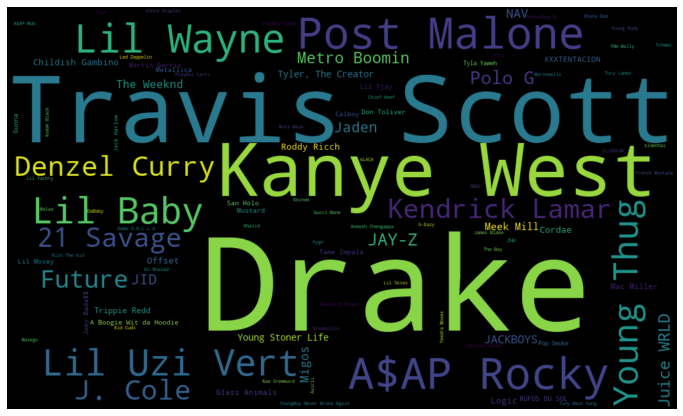

In [34]:
artist_df = streaming_df.groupby('artistName')['sPlayed'].sum()
fig, ax = plt.subplots(figsize=(12,15))
wordcloud = WordCloud(width=1000,height=600, max_words=100,relative_scaling=1,normalize_plurals=False).generate_from_frequencies(artist_df)
ax.imshow(wordcloud, interpolation='bilinear')
plt.axis(False);

In [35]:
# Collecting top 10 songs
artist_df = streaming_df.groupby('artistName')['sPlayed'].sum().reset_index().sort_values(by='sPlayed', ascending=False)
top10 = artist_df['artistName'].to_list()[:10]
# Creating pie chart for top 10 songs
fig = px.pie(artist_df[artist_df['artistName'].isin(top10)], values='sPlayed', names='artistName', title='Percentage of sPlayed for my top 10 artists')
fig.show()

- My most streamed artist (by seconds) were **Drake**, **Travis Scott**, **Kanye West**, **A$AP Rocky** and **Post Malone**.
- Majority of the artists I listen to are rap artists. This...I've known for a while.

## Which of my top 10 artists did I listen to most at which time of day?

In [36]:
artist_df = streaming_df.groupby('artistName')['sPlayed'].sum().reset_index().sort_values(by='sPlayed', ascending=False)
top10 = artist_df['artistName'].to_list()[:10]
top10_df = streaming_df[streaming_df['artistName'].isin(top10)].groupby(['time_of_day', 'artistName'])['sPlayed'].sum().reset_index()
fig = px.bar(top10_df,x='time_of_day',y='sPlayed',color='artistName', title='Top 10 artists during time of day')
fig.show()


- **Travis Scott** seemed to be more of an **afternoon mood**.
- **Drake** was all **morning** and **night**.

## Which of my top 10 artists did I listen to most each month in 2021?

In [38]:
artist_df = streaming_df.groupby('artistName')['sPlayed'].sum().reset_index().sort_values(by='sPlayed', ascending=False)
top10 = artist_df['artistName'].to_list()[:10]
top10_df = streaming_df[streaming_df['artistName'].isin(top10)].groupby(['stream_month', 'artistName'])['sPlayed'].sum().reset_index()
fig = px.line(top10_df,x='stream_month',y='sPlayed',color='artistName', title='Top 10 artists over 2021')
fig.show()

- The spike for Drake and Kanye West in September makes sense because that's when both of their albums dropped.

## Who are some of my most skipped artists?

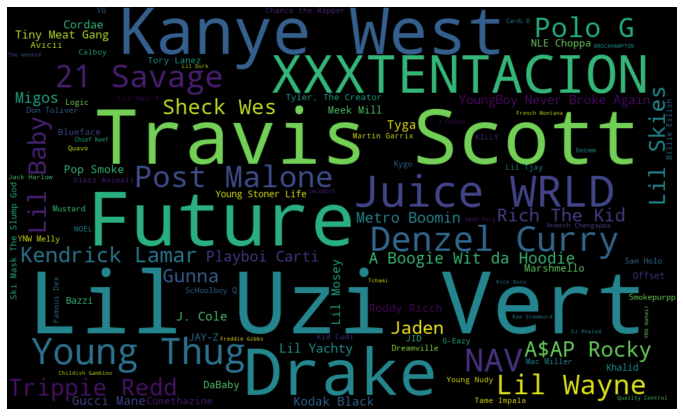

In [39]:
df = streaming_df[streaming_df['skipped_yn']=='Skipped'].groupby('artistName')['endTime'].count()
artist_df = df.sort_values(ascending=False)
fig, ax = plt.subplots(figsize=(12,15))
wordcloud = WordCloud(width=1000,height=600, max_words=100,relative_scaling=1,normalize_plurals=False).generate_from_frequencies(artist_df)
ax.imshow(wordcloud, interpolation='bilinear')
plt.axis(False);

- Looks like **I skip Lil Uzi Vert and XXXTentacion the most**.
- For a more accurate measure of the songs I skip the most, we could look at the ratio of skipped to played and then sort them. But, for now what we've got is okay.

## Top 10 Artists: Audio Features

In [40]:
## top artist audio features
artist_audio = streaming_df.groupby('artistName')['sPlayed'].sum()
artist_audio = artist_audio.sort_values(ascending=False)
top10 = artist_audio.iloc[0:10].index
df = streaming_df[streaming_df['artistName'].isin(top10)]
artist_audio = df.groupby(['artistName'])[audio_features].mean()
artist_audio

,acousticness,danceability,energy,speechiness,liveness,loudness,instrumentalness,tempo,popularity
artistName,,,,,,,,,
A$AP Rocky,0.189310,0.623526,0.742557,0.248164,0.230915,-6.005169,1.164658e-02,124.698680,71.298246
Denzel Curry,0.154380,0.657863,0.723883,0.248256,0.400988,-6.776809,2.158674e-03,113.194248,54.337838
Drake,0.227740,0.637530,0.588785,0.226962,0.165679,-6.827417,2.584533e-03,117.892367,72.481025
Kanye West,0.182802,0.597184,0.617610,0.169278,0.280065,-5.995077,1.691913e-02,115.056142,71.996757
Lil Baby,0.069896,0.772563,0.563596,0.320586,0.174088,-6.349196,3.619375e-06,125.381333,69.526882
Lil Uzi Vert,0.140787,0.775532,0.645824,0.218036,0.216873,-6.148068,8.904636e-07,133.792542,67.457323
Lil Wayne,0.175551,0.636361,0.656973,0.267415,0.217264,-5.794433,7.071223e-04,106.837348,60.973094
Post Malone,0.260660,0.653264,0.645047,0.083505,0.134074,-5.045118,6.715164e-05,132.204884,77.407273
Travis Scott,0.142720,0.666989,0.608894,0.093430,0.210264,-5.401406,3.151369e-04,127.243874,71.012416


- The audio features look pretty similar becayse they are all rap artists.
- **Denzel Curry** is one of my top artists who only has an **average popularity of 54**. Definition of **underrated**, in my opinion.
- It's nice to see that the highest popularity of my top 10 artist Post Malone at 77. However, I do think this is low as well.
- I agree that Young Thug is the most danceable.
- I believe **Lil Wayne should place much higher in the speechiness list**. Listen to 6 Foot 7 Foot - you'll understand.

## What are the average listening percentages for my top 10 artists?

In [41]:
artists = streaming_df.groupby('artistName')['sPlayed'].sum()
artists = artists.sort_values(ascending=False)
top10 = artists.iloc[0:10].index
df = streaming_df[streaming_df['artistName'].isin(top10)]
artists = df.groupby('artistName')['listen_pct'].mean().reset_index().sort_values(by='listen_pct', ascending=False)
fig = px.bar(artists, x='artistName', y='listen_pct', color_discrete_sequence = ['purple'], title='Average Listen Percentage for top 10 artists')
fig.show()

- All of my top artists had a listening percentage below 40%.
- **A$AP Rocky**, **Lil Baby**, **Drake**, and **Post Malone** had **listening percentages above 35%**.

## Which songs did I listen to the most?

In [42]:
song_df = streaming_df.groupby('trackName')['sPlayed'].sum().reset_index()
song_df = song_df.sort_values(by='sPlayed',ascending=False)
song_df.head(10)

,trackName,sPlayed
919,Laugh Now Cry Later (feat. Lil Durk),10744.300
596,Forever,10549.502
1742,The Bigger Picture,8518.695
1922,Wants and Needs (feat. Lil Baby),7985.624
424,Devil In A New Dress,7248.841
1539,She Will,6993.908
76,After Hours,6947.776
5,0 To 100 / The Catch Up,6855.099
47,6 Foot 7 Foot,6639.650
642,Ghetto Symphony (feat. Gunplay & A$AP Ferg),6543.569


In [43]:
# Collecting top 15 songs
top15 = song_df['trackName'].to_list()[:15]
# Creating pie chart for top 15 songs
fig = px.pie(song_df[song_df['trackName'].isin(top15)], values='sPlayed', names='trackName', title='Percentage of sPlayed for my top 15 songs')
fig.show()

- **My favorite song in 2021 was Laugh Now Cry Later**.
- Second place goes to **Forever**.
- Finally, third goes **The Bigger Picture**.

## What are my most listened to songs for each artist in my top 10?

In [44]:
artist_df = streaming_df.groupby('artistName')['sPlayed'].sum().reset_index().sort_values(by='sPlayed', ascending=False)
top10 = artist_df['artistName'].to_list()[:10]
top10_df = streaming_df[streaming_df['artistName'].isin(top10)].groupby(['artistName', 'trackName'])['sPlayed'].sum().reset_index()
top10_df.loc[top10_df.groupby(['artistName'], sort=False)['sPlayed'].idxmax()][['artistName', 'trackName', 'sPlayed']]


,artistName,trackName,sPlayed
8,A$AP Rocky,Ghetto Symphony (feat. Gunplay & A$AP Ferg),6543.569
47,Denzel Curry,ꞌCosmicꞌ.m4a,3841.337
80,Drake,Laugh Now Cry Later (feat. Lil Durk),10744.300
125,Kanye West,Devil In A New Dress,7248.841
202,Lil Baby,The Bigger Picture,8518.695
240,Lil Uzi Vert,Sanguine Paradise,3872.178
274,Lil Wayne,She Will,6993.908
288,Post Malone,Motley Crew,4797.621
332,Travis Scott,STOP TRYING TO BE GOD,5458.512
374,Young Thug,Sin (feat. Jaden Smith),4411.558


This is extremely valuable because I have a hard time picking a song when someone asks me what my favorite song from a certain artist is. Now I can just say 'She Will' when someone asks me what my current favorite song from Lil Wayne is!

## Which of my top 10 songs did I listen to most at which time of day?

In [45]:
song_df = streaming_df.groupby('trackName')['sPlayed'].sum().reset_index().sort_values(by='sPlayed', ascending=False)
top10 = song_df['trackName'].to_list()[:10]
top10_df = streaming_df[streaming_df['trackName'].isin(top10)].groupby(['time_of_day', 'trackName'])['sPlayed'].sum().reset_index()
fig = px.bar(top10_df,x='time_of_day',y='sPlayed',color='trackName', title='Top 10 songs during time of day')
fig.show()

- **Forever** is definitely more of a **night song**

## Which of my top 10 songs did I listen to most each month in 2021?

In [46]:
song_df = streaming_df.groupby('trackName')['sPlayed'].sum().reset_index().sort_values(by='sPlayed', ascending=False)
top10 = song_df['trackName'].to_list()[:10]
top10_df = streaming_df[streaming_df['trackName'].isin(top10)].groupby(['stream_month', 'trackName'])['sPlayed'].sum().reset_index()
fig = px.line(top10_df,x='stream_month',y='sPlayed',color='trackName', title='Top 10 songs over 2021')
fig.show()

- Looks like **I discovered Laugh Now Cry Later (my favorite song of 2021) in February**.
- I discovered Wants and Needs in March.
- I listened to **Forever the most in May** and then stopped listening to it much.

## What are some of my most skipped songs?

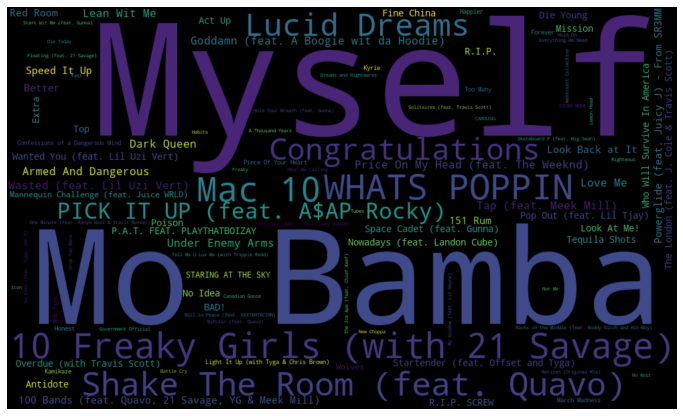

In [47]:
df = streaming_df[streaming_df['skipped_yn']=='Skipped'].groupby('trackName')['endTime'].count()
song_df = df.sort_values(ascending=False)
fig, ax = plt.subplots(figsize=(12,15))
wordcloud = WordCloud(width=1000,height=600, max_words=100,relative_scaling=1,normalize_plurals=False).generate_from_frequencies(song_df)
ax.imshow(wordcloud, interpolation='bilinear')
plt.axis(False);

- **I skip Mo Bamba a lot**. This makes sense because I used to hear it a lot my freshman year of college and then got super annoyed of it.
- **I also skip Myself a lot**. I keep stumbling upon this song when I hit shuffle but I really don't enjoy it that much.

## Top 10 Songs: Audio Features

In [48]:
## top songs audio features
song_audio = streaming_df.groupby('trackName')['sPlayed'].sum()
song_audio = song_audio.sort_values(ascending=False)
top10 = song_audio.iloc[0:10].index
df = streaming_df[streaming_df['trackName'].isin(top10)]
song_audio = df.groupby(['trackName'])[audio_features].mean()
song_audio

,acousticness,danceability,energy,speechiness,liveness,loudness,instrumentalness,tempo,popularity
trackName,,,,,,,,,
0 To 100 / The Catch Up,0.737000,0.5590,0.7160,0.39000,0.25200,-3.9640,0.000000,176.618,73.0
6 Foot 7 Foot,0.000707,0.3650,0.7510,0.30400,0.31800,-5.4290,0.000000,79.119,74.0
After Hours,0.081100,0.6640,0.5720,0.03050,0.12100,-6.0990,0.006040,108.959,78.0
Devil In A New Dress,0.017500,0.4350,0.7600,0.07210,0.15800,-4.9350,0.000000,80.082,78.0
Forever,0.163080,0.5034,0.7744,0.22324,0.14664,-3.7108,0.000000,91.440,58.6
Ghetto Symphony (feat. Gunplay & A$AP Ferg),0.288000,0.4900,0.9210,0.43700,0.48200,-3.3730,0.000000,150.514,63.0
Laugh Now Cry Later (feat. Lil Durk),0.244000,0.7610,0.5180,0.13400,0.10700,-8.8710,0.000035,133.976,84.0
She Will,0.000402,0.3640,0.8410,0.11900,0.24200,-4.8310,0.000000,100.140,68.0
The Bigger Picture,0.012700,0.5900,0.6180,0.33400,0.24400,-5.7560,0.000000,96.459,72.0


- **My most popular song in my top 10 is Wants and Needs (feat. Lil Baby)**.
- The slowest song in my top 10 is Devil in a New Dress, but this is because there's a beautiful guitar solo that comes in halfway through the song.
- **Forever, my second most played song, has a popularity of 58.6**. Just because it's old doesn't mean it can't be popular. A score of 58 with Drake, Lil Wayne, Eminem, and Kanye West all on one song doesn't seem right.

## Which albums did I listen to the most?

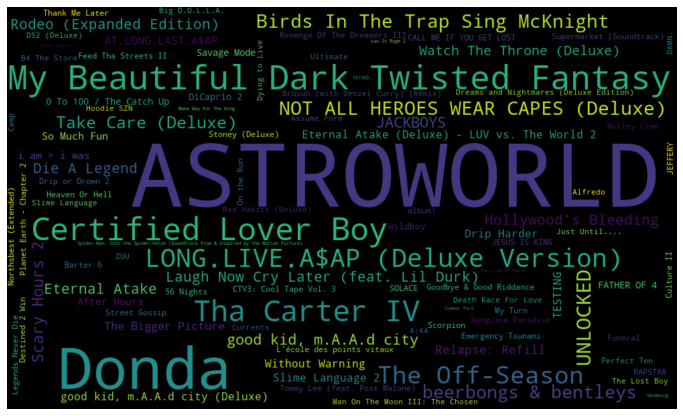

In [49]:
album_df = streaming_df.groupby('album')['sPlayed'].sum()
fig, ax = plt.subplots(figsize=(12,15))
wordcloud = WordCloud(width=1000,height=600, max_words=100,relative_scaling=1,normalize_plurals=False).generate_from_frequencies(album_df)
ax.imshow(wordcloud, interpolation='bilinear')
plt.axis(False);

- The album that I listened to the most in 2021 was **Astroworld**.
- Looks like I also listened to **My Beatiful Dark Twisted Fantasy** a lot - my personal favorite album of all time.

With the power of data, I can also settle one of the largest debates of 2021! With two of the biggest artists of this generation (Drake and Kanye West) dropping albums in 2021, people have heavily argued which one was better. Looks like **I spent more time listening to Donda by Kanye West than Certified Lover Boy by Drake**. The data also reflects my personal opinion of the albums: Sorry Drake, Kanye took 2021. 

# Classics: Released before 2000

## Which classic artists did I listen to the most?

In [50]:
old = streaming_df[streaming_df['release_year'] < 2000]
old = old.groupby('artistName')['sPlayed'].sum().reset_index()
old_artists = old.sort_values('sPlayed', ascending=False)
fig = px.pie(old_artists,names='artistName',values='sPlayed', title='Percentage of sPlayed by classic artists')
fig.show()

- **Metallica seems to be my favorite artist for songs released before 2000**.
- Some of my other classic artists are **Led Zeppelin, Eagles, and Dr. Dre**.

## Which classic songs did I listen to the most?

In [51]:
old = streaming_df[streaming_df['release_year'] < 2000]
old = old.groupby('trackName')['sPlayed'].sum().reset_index()
old_songs = old.sort_values('sPlayed', ascending=False)
old_songs

,trackName,sPlayed
4,Fade To Black (Remastered),2196.885
2,Enter Sandman,2165.617
7,Hotel California - 2013 Remaster,2117.864
12,Stairway to Heaven - Remaster,1972.036
6,Free Bird,1875.265
9,Iron Man,1501.968
0,Bad To The Bone,1307.043
5,Fortunate Son,1274.613
16,The Next Episode,1142.028
10,Master of Puppets (Remastered),1090.973


- My most streamed songs released before 2000 are **Fade to Black**, **Enter Sandman**, **Hotel Claifornia**, **Stairway to Heaven**, and **Free Bird**.
- The data shows my interest in **Heavy Metal** and **Classic Rock**. I did play the guitar for 5 years!

## Audio Features: Top 10 Classic Artists

In [52]:
old = streaming_df[streaming_df['release_year'] < 2000]
grouped = old.groupby('artistName')['sPlayed'].sum()
grp = grouped.sort_values(ascending=False)
top10 = grp.iloc[0:10].index
df = streaming_df[streaming_df['artistName'].isin(top10)]
audio_df = df.groupby(['artistName'])[audio_features].mean()
audio_df

,acousticness,danceability,energy,speechiness,liveness,loudness,instrumentalness,tempo,popularity
artistName,,,,,,,,,
Black Sabbath,0.003510,0.336000,0.792000,0.084000,0.043700,-10.875000,0.001750,155.587000,67.000000
Creedence Clearwater Revival,0.201000,0.640000,0.663000,0.037400,0.152000,-7.516000,0.008060,132.770000,82.000000
Dr. Dre,0.079245,0.880898,0.857041,0.256041,0.073463,-2.775653,0.000120,94.572224,80.551020
Eagles,0.005740,0.579000,0.508000,0.027000,0.057500,-9.484000,0.000494,147.125000,85.000000
Fleetwood Mac,0.009000,0.545000,0.670000,0.049600,0.045100,-8.810000,0.000822,151.553000,82.000000
George Thorogood & The Destroyers,0.006140,0.459000,0.727000,0.030300,0.384000,-11.777000,0.065200,149.231000,73.000000
Led Zeppelin,0.422500,0.400778,0.504444,0.039872,0.180722,-11.498722,0.049256,90.906333,80.444444
Lynyrd Skynyrd,0.073800,0.249000,0.834000,0.057700,0.092400,-8.210000,0.000095,118.223000,76.000000
Metallica,0.002102,0.443507,0.866159,0.061904,0.114188,-8.042014,0.233551,112.935913,69.014493


- Almost all of my top old songs have a substantially higher instrumentalness compared to my top new songs. This makes sense because most new music is more electronic.
- Eagles have a higher popularity than Post Malone. Interesting.
- Black Sabbath and Metallica have a lower popularity. I guess **Heavy Metal is less popular**.
- **Metallica has the highest average energy**. Makes sense when the music simulates a cardiac arrest - a good one, though.

My top old songs follow a similar pattern in audio features, so it's not necessary to look into it further.

## What are the average listening percentages for my top 10 songs?

In [54]:
songs = streaming_df.groupby('trackName')['sPlayed'].sum()
songs = songs.sort_values(ascending=False)
top10 = songs.iloc[0:10].index
df = streaming_df[streaming_df['trackName'].isin(top10)]
songs = df.groupby('trackName')['listen_pct'].mean().reset_index().sort_values(by='listen_pct', ascending=False)
fig = px.bar(songs, x='trackName', y='listen_pct', color_discrete_sequence = ['pink'], title='Average Listen Percentage for top 10 songs')
fig.show()

- **Laugh Now Cry Later had a listen percentage of 69%**! Looks like when I listen to the song, I listen to most of it.
- **All of my top 10 songs had a listen percentage of around 50% or higher**. I listen to at least half of the song, on average, for a top 10 song.

# 'Favorite' Streams: Listen Percentage of 100%+

Before we decide to draw this analysis to a conclusion, let's take a quick look at some of the songs and artists we considered as 'favorites' based on our listening percentage.

## Top songs with the highest average listen_pct (favorite streams)

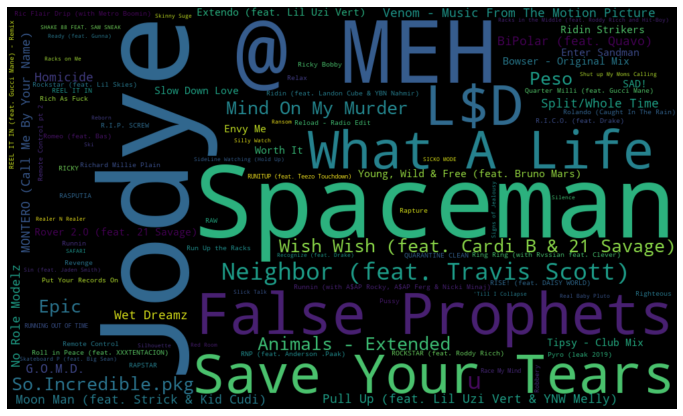

In [55]:
df = streaming_df[streaming_df['favorite_yn']=='Favorite'].groupby('trackName')['listen_pct'].median()
artist_df = df.sort_values(ascending=False)
fig, ax = plt.subplots(figsize=(12,15))
wordcloud = WordCloud(width=1000,height=600, max_words=100,relative_scaling=1,normalize_plurals=False).generate_from_frequencies(artist_df)
ax.imshow(wordcloud, interpolation='bilinear')
plt.axis(False);

- Looks like most of the songs that had a high average listening percentage are streams that I did not listen to multiple times. This suggests that there may be outliers we can find from this feature.
- Although, **I do love Spaceman by Hardwell - my first ever EDM song**.
- To better understand which streams are outliers we can find the songs with the highest average listening percentage and lowest number of streams. But, for the scope of this project we will not explore this.

# Findings & Conclusion

The goal of this project was to complete an epxloratory data analysis to provide insight into my streaming history for 2021.

### Main findings:
- From Dec 2020 to Dec 2021, I've streamed 28,747 tracks.
- The average popularity feature for my streams was high (~70).
- Majority of my streams were under 15 seconds long. This shows that I tend to not listen to most of my streams - I skip tracks a lot.
- **~71% of my streams are skipped.**
- **The goal for my spotify listening, in the future, is to reduce skipped percentage and maximize listening.**
- I tend to skip less popular songs than more popular songs, on average.
- I spent the most time listening to music on Saturdays, and the least time listening on Wednesdays.
- On average, I listened to a stream the longest on Fridays.
- My average listening time per stream is higher for songs released before I was born (2000) than after.
- I listened to music the most at night.
- I listened to a stream for longer, on average, in the mornings and on the weekends.
- **I've streamed 636 unique artists and 2130 unique songs.**
- I've spent ~1228426 seconds listening to music in 2021. This is roughly **341 hours or approximately 14.2 days of listening.**
- On average, I listened to 57 minutes and 76 tracks a day.
- My most streamed artists were **Drake, Travis Scott, Kanye West, ASAP Rocky and Post Malone.**
- Travis Scott was more of an afternoon mood, but Drake was all morning and night.
- The artists **I skipped the most were Lil Uzi Vert and XXXTentacion.**
- ASAP Rocky, Lil Baby, Drake, and Post Malone had listening percentages above 35%.
- My most listened to songs were **Laugh Now Cry Later, Forever, and The Bigger Picture.**
- The songs **I skipped the most are Mo Bamba and Myself.**
- All of my top 10 songs had an average listen percentage of ~50% or higher.
- The albums that I listened to the most were Astroworld and My Beautiful Dark Twisted Fantasy.
- For the big 2021 debate of Donda vs. CLB: **I spent more time listening to Donda by Kanye West than Certified Lover Boy by Drake**. The data also reflects my personal opinion of the albums: Sorry Drake, Kanye took 2021.
- The classic artists I listened to the most were Metallica, Led Zeppelin, Eagles, and Dr. Dre.
- The classic songs I listened to the most were Fade to Black, Enter Sandman, Hotel California, Stairway to Heaven, and Free Bird.

### Next steps
After performing an EDA on my streaming history for 2021, it was clear that there is a high skip percentage in my streams. The majority of my streams are skipped and with the goal in mind to reduce skip percentage and increase listening time, I have decided to pursue another project to meet my listening goals.

This next project will be an unsupervised learning project to cluster my saved songs into groups which can then be used to create playlists in my Spotify account. This will help meet my goal of maximizing listening time through the hypothesis that having playlists based on types of songs would allow me to narrow down my listening to be based on my mood but still allow me to have enough of my songs to shuffle through. Stay tuned for this next project on my github!